In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from prophet import Prophet
from sklearn.metrics import mean_squared_error
color_pal = sns.color_palette()
plt.style.use('fivethirtyeight')

In [3]:
df = pd.read_csv('PJME_hourly.csv', parse_dates=True, index_col='Datetime')

def normalize_data(df):
    scaler = sklearn.preprocessing.MinMaxScaler()
    df['PJME_MW']=scaler.fit_transform(df['PJME_MW'].values.reshape(-1,1))
    return df

df = normalize_data(df)


<IPython.core.display.Javascript object>

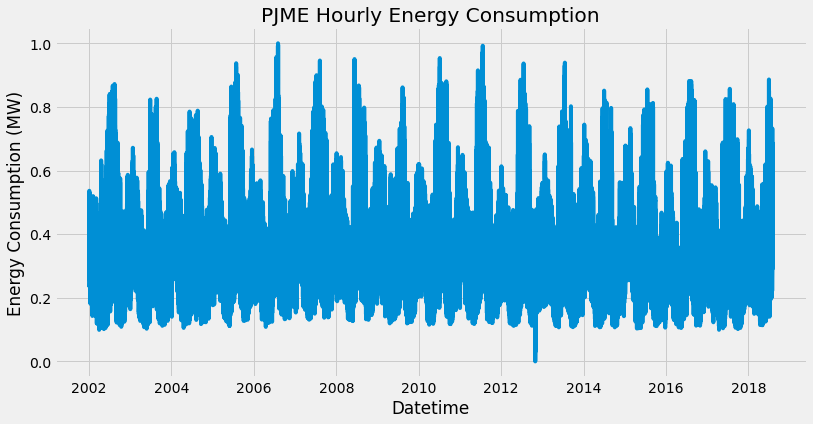

In [4]:
# Plotting the data
plt.figure(figsize=(12,6))
plt.plot(df.index, df['PJME_MW'])
plt.title('PJME Hourly Energy Consumption')
plt.xlabel('Datetime')
plt.ylabel('Energy Consumption (MW)')

# Show the plot
plt.show()

In [5]:

def create_features(df):
    df = df.copy()
    df['hour'] = df.index.hour
    df['dayofweek'] = df.index.dayofweek
    df['quarter'] = df.index.quarter
    df['month'] = df.index.month
    df['year'] = df.index.year
    df['dayofyear'] = df.index.dayofyear
    df['dayofmonth'] = df.index.day
    df['weekofyear'] = df.index.isocalendar().week
    return df

df = create_features(df)

In [8]:
# Split the data into training and test sets
split_date = '2015-01-01'
pjme_train = df.loc[df.index <= split_date].copy()
pjme_test = df.loc[df.index > split_date].copy()

# Rename columns for clarity
pjme_train['Set'] = 'Training Set'
pjme_test['Set'] = 'Test Set'

# Combine training and test sets
combined_data = pd.concat([pjme_train, pjme_test])

# Create a scatter plot using Plotly Express
fig = px.scatter(combined_data, x=combined_data.index, y='PJME_MW', color='Set',
                 title='PJM East: Training and Test Sets',
                 labels={'x': 'Date', 'y': 'Energy (MW)'},
                 width=1000, height=600)

# Update plot aesthetics
fig.update_traces(marker=dict(size=3, opacity=0.7))

# Show legend outside the plot
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="bottom",
    y=1.02,
    xanchor="right",
    x=1
))

fig.show()

In [11]:
df_train_prophet = pjme_train.reset_index() \
    .rename(columns={'Datetime':'ds',
                     'PJME_MW':'y'})

In [12]:
model = Prophet()
model.fit(df_train_prophet)

17:51:11 - cmdstanpy - INFO - Chain [1] start processing
17:53:30 - cmdstanpy - INFO - Chain [1] done processing


In [15]:
df_test_prophet = pjme_test.reset_index() \
    .rename(columns={'Datetime':'ds',
                     'PJME_MW':'y'})

df_test_fcst = model.predict(df_test_prophet)

In [16]:
import plotly.graph_objects as go

# Convert the forecast DataFrame to Plotly-compatible format
forecast_plotly = df_test_fcst.reset_index()

# Create the figure
fig = go.Figure()

# Add the actual data as a scatter plot
fig.add_trace(go.Scatter(x=pjme_test.index, y=pjme_test['PJME_MW'], mode='markers', name='Actual', marker=dict(size=5)))

# Add the forecasted values and confidence intervals as line plots
fig.add_trace(go.Scatter(x=forecast_plotly['ds'], y=forecast_plotly['yhat'], mode='lines', name='Forecast'))
fig.add_trace(go.Scatter(x=forecast_plotly['ds'], y=forecast_plotly['yhat_lower'], mode='lines', name='Lower Bound', line=dict(dash='dash')))
fig.add_trace(go.Scatter(x=forecast_plotly['ds'], y=forecast_plotly['yhat_upper'], mode='lines', name='Upper Bound', line=dict(dash='dash')))

# Update layout
fig.update_layout(title='Prophet Forecast',
                  xaxis_title='Date',
                  yaxis_title='Energy Consumption (MW)',
                  width=1000, height=600)

# Show the plot
fig.show()

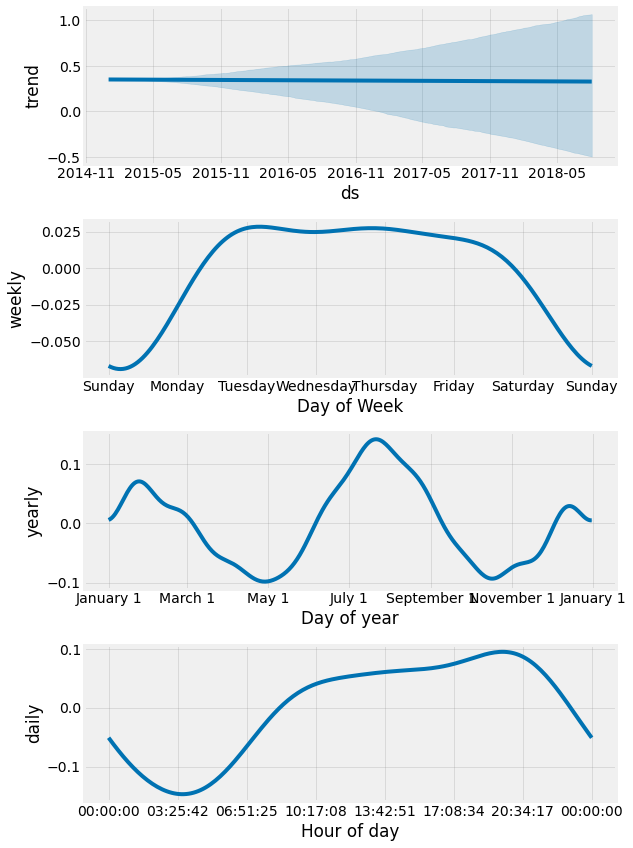

In [18]:
fig = model.plot_components(df_test_fcst)
plt.show()

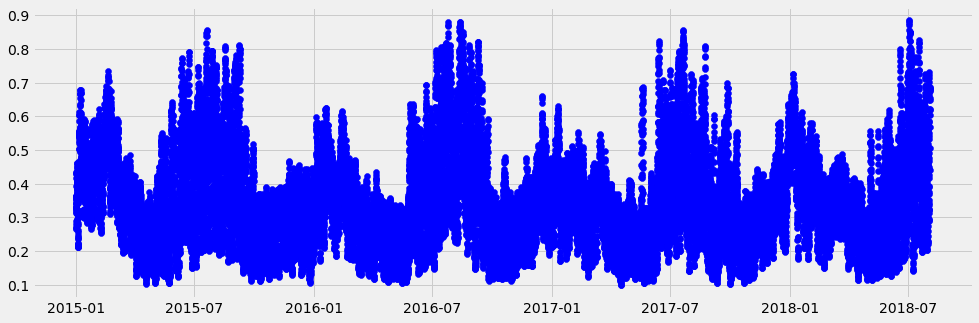

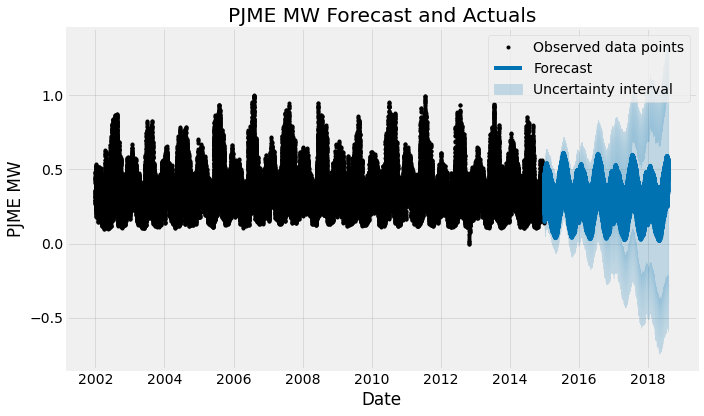

In [19]:
import matplotlib.pyplot as plt

# Plot actuals
plt.figure(figsize=(15, 5))  # Set desired figure size
plt.scatter(pjme_test.index, pjme_test["PJME_MW"], color='blue', label='Actuals')

# Plot forecast using Prophet's built-in plotting
fig = model.plot(df_test_fcst)
plt.legend()  # Add legend after Prophet's plot (optional)

# Customize labels and title (optional)
plt.xlabel('Date')
plt.ylabel('PJME MW')
plt.title('PJME MW Forecast and Actuals')

# Show the plot
plt.tight_layout()
plt.show()


In [21]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
import numpy as np

# Calculate Root Mean Squared Error (RMSE)
rmse = np.sqrt(mean_squared_error(y_true=pjme_test['PJME_MW'], y_pred=df_test_fcst['yhat']))

# Calculate Mean Absolute Error (MAE)
mae = mean_absolute_error(y_true=pjme_test['PJME_MW'], y_pred=df_test_fcst['yhat'])

# Print the results
print(f"Root Mean Squared Error (RMSE): {rmse:.2f}")
print(f"Mean Absolute Error (MAE): {mae:.2f}")

Root Mean Squared Error (RMSE): 0.14
Mean Absolute Error (MAE): 0.11


In [38]:
from sklearn.metrics import r2_score

# Calculate R^2 score
r2 = r2_score(pjme_test['PJME_MW'],df_test_fcst['yhat'])

# Print the R^2 score
print(r2)


-0.05085186712030665


In [24]:
df_test_fcst

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2015-01-01 01:00:00,0.351562,0.191931,0.386244,0.351562,0.351562,-0.060656,-0.060656,-0.060656,-0.093339,...,0.026996,0.026996,0.026996,0.005687,0.005687,0.005687,0.0,0.0,0.0,0.290906
1,2015-01-01 02:00:00,0.351562,0.163331,0.352366,0.351562,0.351562,-0.092351,-0.092351,-0.092351,-0.124876,...,0.026811,0.026811,0.026811,0.005713,0.005713,0.005713,0.0,0.0,0.0,0.259211
2,2015-01-01 03:00:00,0.351561,0.144338,0.335690,0.351561,0.351561,-0.110717,-0.110717,-0.110717,-0.143059,...,0.026602,0.026602,0.026602,0.005741,0.005741,0.005741,0.0,0.0,0.0,0.240844
3,2015-01-01 04:00:00,0.351560,0.148698,0.330135,0.351560,0.351560,-0.113701,-0.113701,-0.113701,-0.145839,...,0.026369,0.026369,0.026369,0.005769,0.005769,0.005769,0.0,0.0,0.0,0.237859
4,2015-01-01 05:00:00,0.351559,0.152138,0.350055,0.351559,0.351559,-0.099496,-0.099496,-0.099496,-0.131410,...,0.026116,0.026116,0.026116,0.005798,0.005798,0.005798,0.0,0.0,0.0,0.252064
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31434,2018-08-02 20:00:00,0.328845,-0.285826,1.329920,-0.494594,1.069224,0.238476,0.238476,0.238476,0.093777,...,0.021781,0.021781,0.021781,0.122917,0.122917,0.122917,0.0,0.0,0.0,0.567321
31435,2018-08-02 21:00:00,0.328845,-0.273163,1.296177,-0.494636,1.069251,0.222195,0.222195,0.222195,0.077866,...,0.021515,0.021515,0.021515,0.122813,0.122813,0.122813,0.0,0.0,0.0,0.551039
31436,2018-08-02 22:00:00,0.328844,-0.327304,1.284035,-0.494678,1.069279,0.187870,0.187870,0.187870,0.043915,...,0.021246,0.021246,0.021246,0.122709,0.122709,0.122709,0.0,0.0,0.0,0.516714
31437,2018-08-02 23:00:00,0.328843,-0.372559,1.213661,-0.494720,1.069306,0.141357,0.141357,0.141357,-0.002217,...,0.020969,0.020969,0.020969,0.122605,0.122605,0.122605,0.0,0.0,0.0,0.470200
